
<h1 style="text-align: center; fon-weight: bold;">CPI Data Analysis (India)</h1>


!['CPI'](CPI_image.webp)


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.offline import plot, iplot, init_notebook_mode
init_notebook_mode(connected=True)
#import matplotlib
import matplotlib.animation as animation
from sqlalchemy import create_engine, text
pd.options.display.float_format = '{:.4f}'.format
import logging

import glob
import os
# matplotlib.rcParams.update({'font.size': 8})
import matplotlib as mpl

from gtts import gTTS
# Manually set the path to the ffmpeg executable
mpl.rcParams['animation.ffmpeg_path'] = r'D:\ffmpeg-7.1-full_build\bin\ffmpeg.exe'

import warnings

# Suppress all warnings
warnings.filterwarnings('ignore')



In [2]:
df = pd.read_sql('SELECT * FROM "India_CPI_Final" ORDER BY date', con=engine)
# df

NameError: name 'engine' is not defined

In [4]:
df.date = pd.to_datetime(df.date)
# df.info()

In [5]:

# Convert the 'rural' column to numeric
df['rural'] = pd.to_numeric(df['rural'], errors='coerce')
df['urban'] = pd.to_numeric(df['urban'], errors='coerce')
df['combined'] = pd.to_numeric(df['combined'], errors='coerce')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 98029 entries, 0 to 98028
Data columns (total 11 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         98029 non-null  datetime64[ns]
 1   year         98029 non-null  object        
 2   month        98029 non-null  int64         
 3   state        98029 non-null  object        
 4   group        97991 non-null  object        
 5   sub_group    62660 non-null  object        
 6   description  98029 non-null  object        
 7   rural        93112 non-null  float64       
 8   urban        97203 non-null  float64       
 9   combined     92592 non-null  float64       
 10  status       98029 non-null  object        
dtypes: datetime64[ns](1), float64(3), int64(1), object(6)
memory usage: 8.2+ MB


In [6]:
df = df.sort_values(by='date')
# df

In [7]:
#combined and if not avilable then urban values are considered
#  = 
# [if pd.notnull(df['combined'][i]) else df['urban'][i] for i in range(len(df))]

# Custom logic for handling combined and urban
def cpi_combined(row):
    if pd.notnull(row['combined']):
        return row['combined']  # Use combined if it's not null
    elif pd.notnull(row['urban']):
        return row['urban']  # Use urban if combined is null
    else:
        # Use mean of combined and urban if both are available but different
        return np.nan

# Apply the custom logic row-wise
df["CPI_final"]= df.apply(cpi_combined, axis=1)

#df[(df.state == 'Arunachal Pradesh')&(df.combined.notnull())]
df

,date,year,month,state,group,sub_group,description,rural,urban,combined,status,CPI_final
0,2013-01-01,2013,1,Punjab,1.0,1.2.11,Non-alcoholic beverages,103.4000,104.3000,103.8000,F,103.8000
475,2013-01-01,2013,1,Chhattisgarh,1.0,1.1.05,Oils and fats,103.7000,103.9000,103.8000,F,103.8000
476,2013-01-01,2013,1,Bihar,1.0,1.1.05,Oils and fats,109.0000,102.3000,108.2000,F,108.2000
477,2013-01-01,2013,1,Assam,1.0,1.1.05,Oils and fats,109.4000,105.7000,108.8000,F,108.8000
478,2013-01-01,2013,1,Andhra Pradesh,1.0,1.1.05,Oils and fats,103.7000,102.7000,103.4000,F,103.4000
...,...,...,...,...,...,...,...,...,...,...,...,...
97551,2024-09-01,2024,9,Karnataka,1,1.2.11,Non-alcoholic beverages,202.3000,185.5000,194.4000,P,194.4000
97552,2024-09-01,2024,9,Kerala,1,1.2.11,Non-alcoholic beverages,172.4000,172.6000,172.5000,P,172.5000
97553,2024-09-01,2024,9,Madhya Pradesh,1,1.2.11,Non-alcoholic beverages,172.2000,164.7000,169.6000,P,169.6000
97555,2024-09-01,2024,9,Odisha,1,1.2.11,Non-alcoholic beverages,157.3000,138.5000,153.1000,P,153.1000


In [8]:
df.isnull().sum()

date               0
year               0
month              0
state              0
group             38
sub_group      35369
description        0
rural           4917
urban            826
combined        5437
status             0
CPI_final        772
dtype: int64

In [9]:
# sub group weights in 2012

In [10]:
def cpi_weights(file):
    CPI_weights = pd.read_excel(file)
    CPI_weights.Group = CPI_weights.Group.apply(str)
    MG_list = list(CPI_weights[CPI_weights['SubGroup'].isna()]["Item"])
    MG_condition = (CPI_weights["Item"].isin(MG_list))
    Major_groups = CPI_weights[MG_condition].sort_values('Urban',ascending=False)
    Sub_groups = CPI_weights[~MG_condition].sort_values('Urban',ascending=False)
    Subgroups_Majorgroup_no = [x[0] for x in Sub_groups.SubGroup]
    Subgroups_Majorgroup_text = Sub_groups.Item + ": Major Group- " +Subgroups_Majorgroup_no
    Majorgroup_text = Major_groups.Item[1:] + ": Group No. - " +Major_groups.Group[1:]
    
    fig, ax = plt.subplots(figsize=(12,8))
    ax.pie(Major_groups.Urban[1:], labels=Majorgroup_text, autopct='%1.1f%%')
    plt.title("CPI Group wise weights - 2012");
    plt.savefig("India_CPI_groups_weight.png")

    fig1, ax1 = plt.subplots(figsize=(12,8))
    ax1.pie(Sub_groups.Urban, labels=Subgroups_Majorgroup_text, autopct='%1.1f%%')
    plt.title("CPI Subgroup wise weights - 2012");
    plt.savefig("India_CPI_subgroups_weight.png")
    return Major_groups, Sub_groups
    

## Group and Sub-group wise weightage in CPI

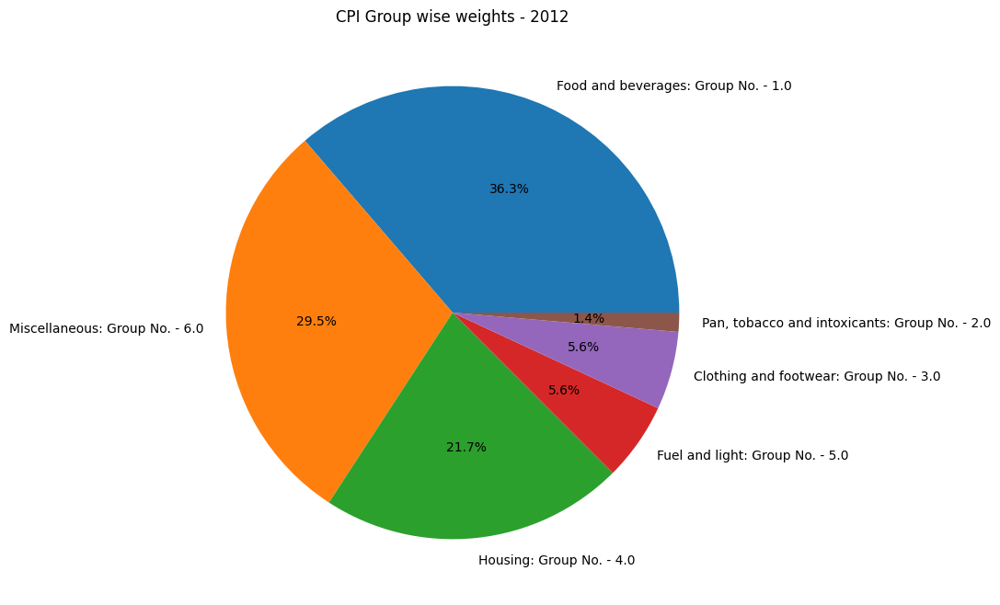

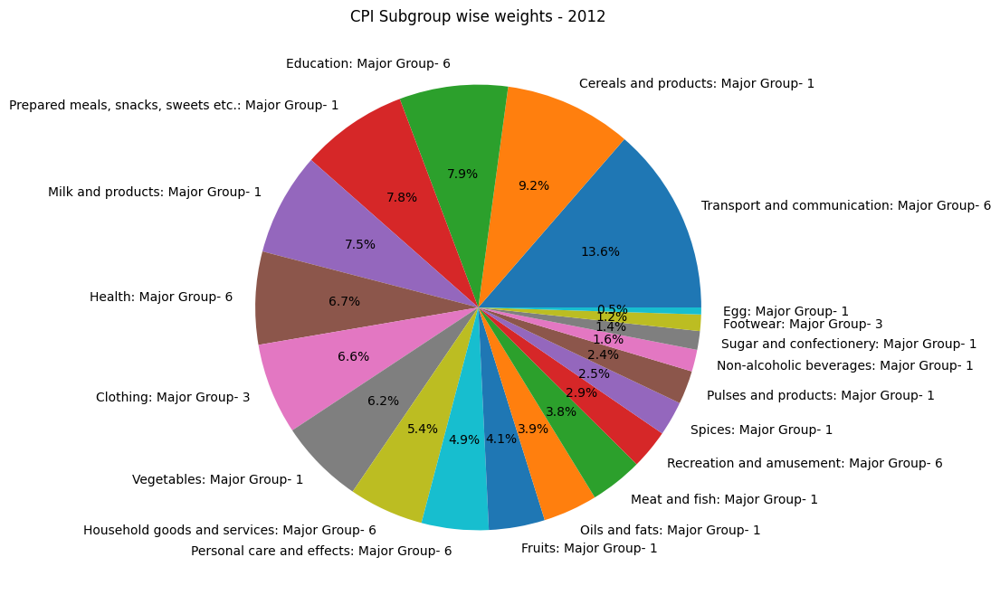

In [11]:
filename = "CPI_weights_2012.xlsx"

Major_groups, Sub_groups = cpi_weights(filename)

In [12]:
# CPI Analysis

In [13]:
# df[df.group.isnull()]

In [14]:
df.group[df.description=='General Index (All Groups)'] = 'General Index (All Groups)'
# df[df.description=='General Index (All Groups)']

In [15]:
df.sub_group[df.description=='General Index (All Groups)'] = 'General Index (All Groups)'
# df[df.description=='General Index (All Groups)']

In [16]:
df.group[df.description=='Consumer Food Price Index'] = 'Consumer Food Price Index'
df.sub_group[df.description=='Consumer Food Price Index'] = 'Consumer Food Price Index'
# df[df.description=='Consumer Food Price Index']

In [17]:
df.sub_group[df.description=='Housing'] = 'Housing'
# df[df.description=='Housing']

In [18]:
df.sub_group[df.description=='Pan; tobacco; and intoxicants'] = 'Pan; tobacco; and intoxicants'
# df[df.description=='Pan; tobacco; and intoxicants']

In [19]:
df.sub_group[df.description=='Food and beverages'] = 'Food and beverages'
# df[df.description=='Food and beverages']

In [20]:
df.sub_group[df.description=='Fuel and light']= 'Fuel and light'
# df[df.description=='Fuel and light']

In [21]:
df.sub_group[df.description=='Miscellaneous'] = 'Other_Miscellaneous'
# df[df.description == 'Miscellaneous']

In [22]:
# df[df.sub_group.isnull()]

In [23]:
df.sub_group[df.description == 'Clothing and footwear'] = 'Clothing and footwear'
# df[df.description == 'Clothing and footwear']

In [24]:
# df.rural[(df.rural.isnull()) & (df.sub_group == 'Housing')] = 'Unknown'
# df[(df.sub_group == 'Housing')]

In [25]:
# df.combined[(df.combined.isnull()) & (df.sub_group == 'Housing')] = 'Unknown'
# df[(df.sub_group == 'Housing')]

In [26]:
# df.rural
# df.info()

### There are few null values which needs to be checked.

In [94]:
# df.isnull().sum()

In [28]:
# M_1 = df[(df.state=='Manipur')&(df.description == 'Pan; tobacco; and intoxicants')].groupby(['description', 'date'])['rural'].sum().reset_index()
# M_1

In [29]:
# complete date range

# Step 1: Generate complete date range (monthly in your case)
full_date_range = pd.date_range(start=df['date'].min(), end=df['date'].max(), freq='MS')

existing_dates = df.date.unique()

#missing_dates = full_date_range.difference(existing_dates)

#print('missing dates: ', missing_dates)

states = df.state.unique()
descriptions = df.description.unique()


In [30]:
all_combinations = pd.DataFrame(
    [(state, description, date) for state in states for description in descriptions for date in full_date_range],
    columns=['state', 'description', 'date']
)
# all_combinations

### Final datset to check all missing values

#### Here, i have created another data based on all possible combination and then merged newly created data with original data (left join on all combinations of data)

In [31]:
merged_data = all_combinations.merge(df, on=['state', 'description', 'date'], how='left')
merged_data

,state,description,date,year,month,group,sub_group,rural,urban,combined,status,CPI_final
0,Punjab,Non-alcoholic beverages,2013-01-01,2013,1.0000,1.0,1.2.11,103.4000,104.3000,103.8000,F,103.8000
1,Punjab,Non-alcoholic beverages,2013-02-01,2013,2.0000,1.0,1.2.11,103.3000,104.5000,103.8000,F,103.8000
2,Punjab,Non-alcoholic beverages,2013-03-01,2013,3.0000,1.0,1.2.11,103.8000,105.2000,104.4000,F,104.4000
3,Punjab,Non-alcoholic beverages,2013-04-01,2013,4.0000,1.0,1.2.11,105.5000,106.2000,105.8000,F,105.8000
4,Punjab,Non-alcoholic beverages,2013-05-01,2013,5.0000,1.0,1.2.11,105.7000,107.4000,106.4000,F,106.4000
...,...,...,...,...,...,...,...,...,...,...,...,...
146071,Manipur,Prepared meals; snacks; sweets etc.,2024-05-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
146072,Manipur,Prepared meals; snacks; sweets etc.,2024-06-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
146073,Manipur,Prepared meals; snacks; sweets etc.,2024-07-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
146074,Manipur,Prepared meals; snacks; sweets etc.,2024-08-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


#### Null data based on all possible combination

In [32]:
merged_data.isnull().sum()

state              0
description        0
date               0
year           48047
month          48047
group          48047
sub_group      48047
rural          52964
urban          48873
combined       53484
status         48047
CPI_final      48819
dtype: int64

In [33]:
# Step 3: Identify missing data 
# misisng data on urban data
missing_data = merged_data[merged_data['CPI_final'].isnull()]  # Assuming 'combined' is the key column

# Step 4: Analyze missing data
# print("Missing data summary:")
# print(missing_data.groupby(['date','state', 'description'])['date'].count())

In [34]:
# Add random jitter between 1 and 10 days to prevent overlapping points
missing_data['jittered_date'] = missing_data['date'] + pd.to_timedelta(
    np.random.uniform(1, 10, size=len(missing_data)), unit='D'
)
# Format date for display as month and year only
missing_data['formatted_date'] = missing_data['date'].dt.strftime('%b %Y')


In [35]:
# print(len(missing_data.state.unique()))
# print(len(missing_data.description.unique()))
# print(len(missing_data.year.unique()))

In [36]:
missing_data['year'] = missing_data['date'].dt.year.apply(str)
# missing_data

In [37]:
# missing_data.groupby(['state','description','year'])['date'].count().reset_index()

In [38]:
# Group by state, description, and year wise date to calculate the counts
missing_counts = missing_data.groupby(['state','description','year'])['date'].count().reset_index()
missing_counts.columns = ['state',	'description','year'	,'yearly_missing_counts']
# missing_counts

In [39]:
# Combine state and year into a single column
missing_counts['state_year'] = missing_counts['state'] + "_" + missing_counts['year'].astype(str)
missing_counts['description_year'] = missing_counts['description'] + "_" + missing_counts['year'].astype(str)
missing_counts['state_description'] = missing_counts['state'] + "_" + missing_counts['description']
# missing_counts

In [40]:
missing_data = missing_data.merge(missing_counts, on=['state', 'description', 'year'], how='left')
# missing_data

In [41]:
missing_data.sort_values(by='formatted_date', inplace=True)

In [42]:
# missing_data['count'] = missing_data.groupby(['state', 'description', 'date'])['date'].transform('count')

In [43]:
# missing_counts = missing_counts.sort_values(by='year')
# missing_counts

## Interactive visualisation based on all

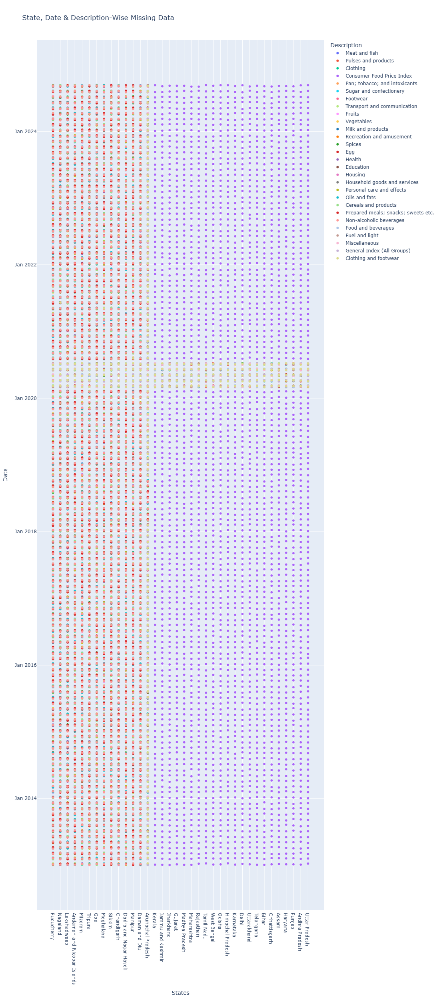

In [44]:
import plotly.express as px

# Custom color palette with 28 unique colors
custom_colors = [
    "#636EFA", "#EF553B", "#00CC96", "#AB63FA", "#FFA15A",
    "#19D3F3", "#FF6692", "#B6E880", "#FF97FF", "#FECB52",
    "#1F77B4", "#FF7F0E", "#2CA02C", "#D62728", "#9467BD",
    "#8C564B", "#E377C2", "#7F7F7F", "#BCBD22", "#17BECF",
    "#98DF8A", "#D62728", "#FF9896", "#AEC7E8", "#C49C94",
    "#F7B6D2", "#C5B0D5", "#DBDB8D"
]

# custom_colors = [
#     "#636EFA", "#EF553B", "#00CC96", "#AB63FA", "#FFA15A",
#     "#19D3F3", "#FF6692", "#B6E880", "#FF97FF", "#FECB52",
#     "#1F77B4"
# ]

# Interactive scatter plot of missing data
fig = px.scatter(
    missing_data,
    x='state',
    y='jittered_date',
    color='description',
    # size='Total_missing_counts',
    title='State, Date & Description-Wise Missing Data',
    labels={'state': 'State', 'formatted_date': 'Date', 'description': 'Description'},
    hover_data={'formatted_date':True,'jittered_date':False ,'date':False, 'yearly_missing_counts':True, 'year':True},
    color_discrete_sequence=custom_colors  # Unique colors
)
fig.update_layout(height=2500, width=1100, showlegend=True,
    legend_title_text='Description',
    xaxis_title="States",
    yaxis=dict(title="Date", tickformat="%b %Y"),)  # Format y-axis ticks)
fig.show()


In [45]:
missing_data_2 = missing_data[missing_data.description!='Consumer Food Price Index']
# missing_data_2

In [46]:
# import plotly.express as px

# # Custom color palette with 28 unique colors
# custom_colors = [
#     "#636EFA", "#EF553B", "#00CC96", "#AB63FA", "#FFA15A",
#     "#19D3F3", "#FF6692", "#B6E880", "#FF97FF", "#FECB52",
#     "#1F77B4", "#FF7F0E", "#2CA02C", "#D62728", "#9467BD",
#     "#8C564B", "#E377C2", "#7F7F7F", "#BCBD22", "#17BECF",
#     "#98DF8A", "#D62728", "#FF9896", "#AEC7E8", "#C49C94",
#     "#F7B6D2", "#C5B0D5", "#DBDB8D"
# ]

# # custom_colors = [
# #     "#636EFA", "#EF553B", "#00CC96", "#AB63FA", "#FFA15A",
# #     "#19D3F3", "#FF6692", "#B6E880", "#FF97FF", "#FECB52",
# #     "#1F77B4"
# # ]

# # Interactive scatter plot of missing data
# fig = px.scatter(
#     missing_data,
#     x='state',
#     y='jittered_date',
#     color='description',
#     # size='Total_missing_counts',
#     title='State & Description-Wise Missing Data',
#     labels={'state': 'State', 'formatted_date': 'Date', 'description': 'Description'},
#     hover_data={'formatted_date':True,'jittered_date':False ,'date':False, 'yearly_missing_counts':True, 'year':True},
#     color_discrete_sequence=custom_colors  # Unique colors
# )
# fig.update_layout(height=2500, width=1100, showlegend=True,
#     legend_title_text='Year',
#     xaxis_title="Description",
#     yaxis=dict(title="Date", tickformat="%b %Y"),)  # Format y-axis ticks)
# fig.show()


## Interactive visualisation after removing Food Price Index

#### This is because food Price Index is aonly avilable for All India and not for state wise.

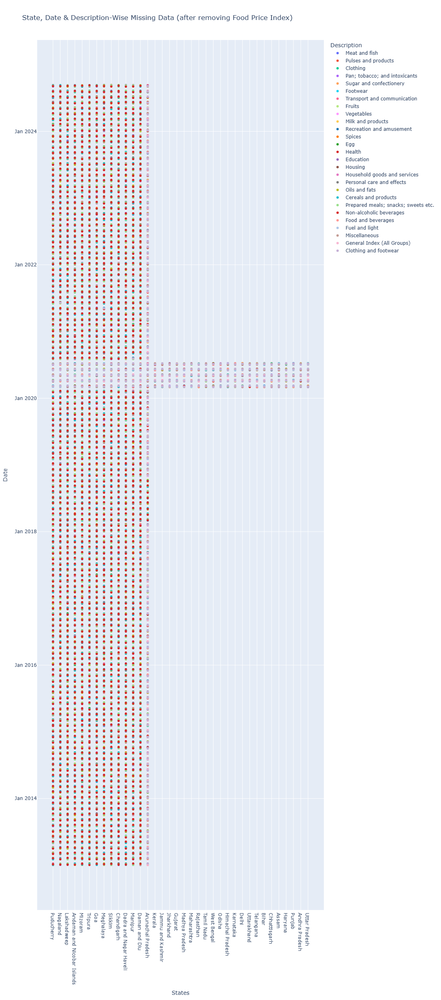

In [47]:
import plotly.express as px

# Custom color palette with 28 unique colors
custom_colors = [
    "#636EFA", "#EF553B", "#00CC96", "#AB63FA", "#FFA15A",
    "#19D3F3", "#FF6692", "#B6E880", "#FF97FF", "#FECB52",
    "#1F77B4", "#FF7F0E", "#2CA02C", "#D62728", "#9467BD",
    "#8C564B", "#E377C2", "#7F7F7F", "#BCBD22", "#17BECF",
    "#98DF8A", "#D62728", "#FF9896", "#AEC7E8", "#C49C94",
    "#F7B6D2", "#C5B0D5", "#DBDB8D"
]

# custom_colors = [
#     "#636EFA", "#EF553B", "#00CC96", "#AB63FA", "#FFA15A",
#     "#19D3F3", "#FF6692", "#B6E880", "#FF97FF", "#FECB52",
#     "#1F77B4"
# ]

# Interactive scatter plot of missing data
fig = px.scatter(
    missing_data_2,
    x='state',
    y='jittered_date',
    color='description',
    # size='Total_missing_counts',
    title='State, Date & Description-Wise Missing Data (after removing Food Price Index)',
    labels={'state': 'State', 'formatted_date': 'Date', 'description': 'Description'},
    hover_data={'formatted_date':True,'jittered_date':False ,'date':False, 'yearly_missing_counts':True, 'year':True},
    color_discrete_sequence=custom_colors  # Unique colors
)
fig.update_layout(height=2500, width=1100, showlegend=True,
    legend_title_text='Description',
    xaxis_title="States",
    yaxis=dict(title="Date", tickformat="%b %Y"),)  # Format y-axis ticks)
fig.show()


### Missing values by States and Description

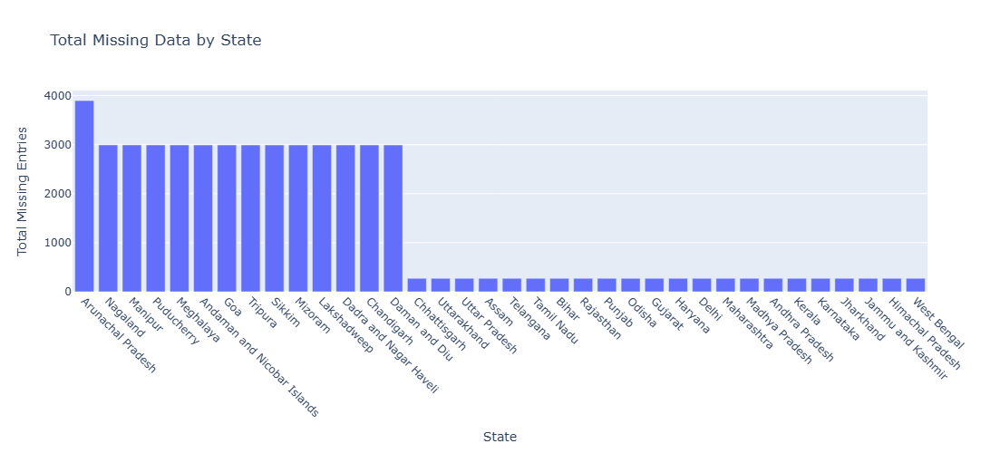

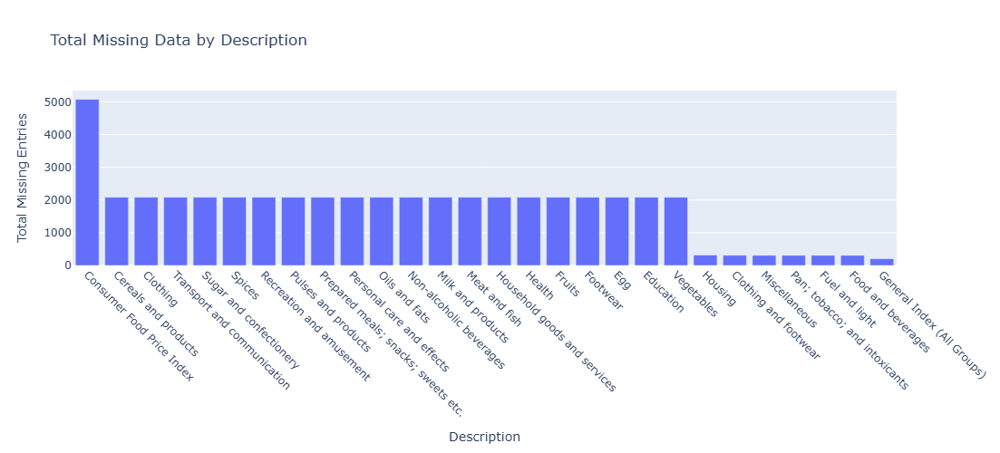

In [48]:
# Summarize missing data by state
missing_by_state = missing_data.groupby('state').size().reset_index(name='total_missing').sort_values(by='total_missing', ascending=False)

# Summarize missing data by description
missing_by_description = missing_data.groupby('description').size().reset_index(name='total_missing').sort_values(by='total_missing', ascending=False)

# Plot missing data by state
fig1 = px.bar(
    missing_by_state,
    x='state',
    y='total_missing',
    title='Total Missing Data by State',
    labels={'total_missing': 'Total Missing Entries', 'state': 'State'},
    height = 500
)
fig1.update_layout(xaxis=dict(tickangle=45))
fig1.show()

# Plot missing data by description
fig2 = px.bar(
    missing_by_description,
    x='description',
    y='total_missing',
    title='Total Missing Data by Description',
    labels={'total_missing': 'Total Missing Entries', 'description': 'Description'},
    height=500
)
fig2.update_layout(xaxis=dict(tickangle=45))
fig2.show()


### Missing Values by States and Description (after removing food Price Index)

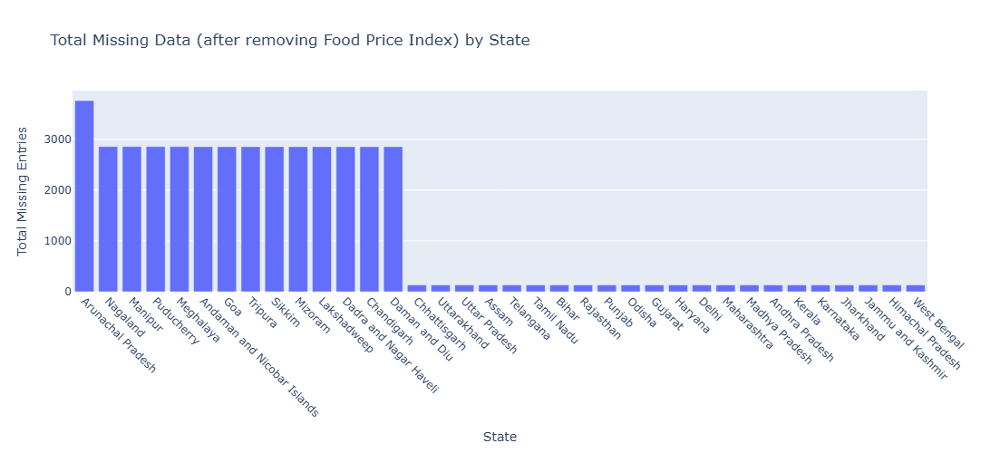

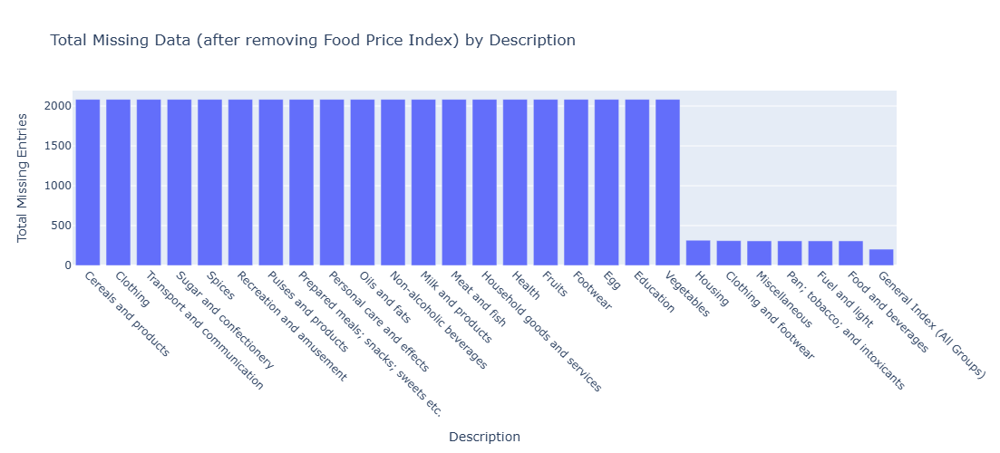

In [49]:
# Summarize missing data by state
missing_by_state_2 = missing_data_2.groupby('state').size().reset_index(name='total_missing').sort_values(by='total_missing', ascending=False)

# Summarize missing data by description
missing_by_description_2 = missing_data_2.groupby('description').size().reset_index(name='total_missing').sort_values(by='total_missing', ascending=False)

# Plot missing data by state
fig1 = px.bar(
    missing_by_state_2,
    x='state',
    y='total_missing',
    title='Total Missing Data (after removing Food Price Index) by State',
    labels={'total_missing': 'Total Missing Entries', 'state': 'State'},
    height = 500
)
fig1.update_layout(xaxis=dict(tickangle=45))
fig1.show()

# Plot missing data by description
fig2 = px.bar(
    missing_by_description_2,
    x='description',
    y='total_missing',
    title='Total Missing Data (after removing Food Price Index) by Description',
    labels={'total_missing': 'Total Missing Entries', 'description': 'Description'},
    height=500
)
fig2.update_layout(xaxis=dict(tickangle=45))
fig2.show()


In [93]:
# missing_data_3[(missing_data_3.state=='Goa')&(missing_data_3.year!='2020')&(missing_data_3.year!='2024')].date.sum()

In [50]:
missing_data_2 = missing_data_2.sort_values(by='date')
missing_data_3 = missing_data_2.groupby(["year","state", "description"])['date'].count().reset_index()
# missing_data_3

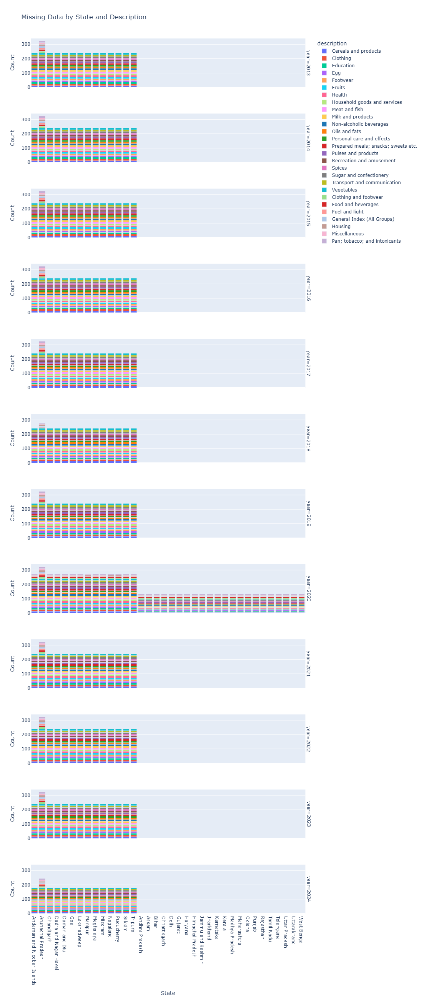

In [51]:
import plotly.express as px

# Create a bar chart
fig = px.bar(
    missing_data_3,  # Replace with your DataFrame
    x='state',
    y='date',  # Column with the count
    color='description',
    barmode='stack',  # Stack bars for easier comparison
    facet_row='year',  # Separate charts for each year
    title='Missing Data by State and Description',
    labels={'date': 'Count', 'state': 'State'},
    # facet_wrap=12,
    height=2600,
    width=1000,
    color_discrete_sequence=custom_colors
)

fig.show()


### States with missing data

In [52]:
Minor_missing= ['Jammu and Kashmir',
 'West Bengal',
 'Rajasthan',
 'Madhya Pradesh',
 'Odisha',
 'Karnataka',
 'Gujarat',
 'Haryana',
 'Tamil Nadu',
 'Himachal Pradesh',
 'Chhattisgarh',
 'Jharkhand',
 'Punjab',
 'Andhra Pradesh',
 'Uttar Pradesh',
 'Maharashtra',
 'Telangana',
 'Assam',
 'Kerala',
 'Bihar',
 'Delhi',
 'Uttarakhand'] 

Major_missing = ['Andaman and Nicobar Islands',
 'Arunachal Pradesh',
 'Chandigarh',
 'Dadra and Nagar Haveli',
 'Daman and Diu',
 'Goa',
 'Lakshadweep',
 'Manipur',
 'Meghalaya',
 'Mizoram',
 'Nagaland',
 'Puducherry',
 'Sikkim',
 'Tripura']

In [81]:
# df[(df.year != '2021')&(df.state == 'Arunachal Pradesh')&(df.CPI_final.notnull())].description.unique()

In [80]:
#Major missing states other than 2021 and other than state Arunachal pradesh with no null CPI final value
# len(df[(df.year != '2021')&(df.state.isin(Minor_missing))&(df.state != 'Arunachal Pradesh')&(df.CPI_final.notnull())].description.unique())

In [79]:
# len(missing_data_3[(missing_data_3.state.isin(Major_missing))&((df.year != '2021'))&(df.state != 'Arunachal Pradesh')].description.unique())

In [78]:
# (missing_data_3[(missing_data_3.year!='2020')&((missing_data_3.year!='2021'))].state.unique())

In [77]:
# list(set(missing_data_3.state.unique()) - set(missing_data_3[(missing_data_3.year!='2020')&((missing_data_3.year!='2021'))].state.unique()))

In [76]:
# len(missing_data_3[(missing_data_3.state == 'Arunachal Pradesh')&((missing_data_3.description != 'Miscellaneous'))].description.unique())

#### Key Pointers
- **Consumer Food Price Index** is only available for all India - Not state wise
- Out of **36 States and UT's 14 (~39% of All States/UTs) are showing missing data** for most of the products. 
- In case of **Arunachal Pradesh** except *Housing* all *Major Groups* CPI indices are available.
- **Major missing states** (in table below) other than *Arunachal Pradesh* shows all *Major Groups* CPI indices.
- **Minor missing states** are providing both *major groups and their sub groups* CPI data.
- The below table is showing **Major Missing States and Minor Missing States**

In [69]:
Major_group = list(Major_groups['Item'])
Minor_group = list(Sub_groups['Item'])

In [75]:


while len(Major_missing) < len(Minor_missing):
    Major_missing.append(' ')


# Create DataFrame
pd.DataFrame({
    'States with Minor Missing Data': Minor_missing,
    'States with Major Missing Data': Major_missing
})

,States with Minor Missing Data,States with Major Missing Data
0,Jammu and Kashmir,Andaman and Nicobar Islands
1,West Bengal,Arunachal Pradesh
2,Rajasthan,Chandigarh
3,Madhya Pradesh,Dadra and Nagar Haveli
4,Odisha,Daman and Diu
5,Karnataka,Goa
6,Gujarat,Lakshadweep
7,Haryana,Manipur
8,Tamil Nadu,Meghalaya
9,Himachal Pradesh,Mizoram
